I pre-processed this mouse stroke single cell dataset previously by ScanPy.\
Here, I will pre-process it using Seurat, scCustomize and some bioconductor packages.\
I intend to do some in-depth exploratory analysis on the data. In ScanPy analysis,\
I observed some batch effects and performed integration by scvi-tools. I also transferred\
these embeddings to the Seurat object from the anndata object.

I will use some command and analysis approaches from the PART_4A notebook\
such as scater::plotExplanatoryVariables, and scran::modelGeneVar. 

FIRST PART OF PART_4B NOTREBOOK !!!

In [1]:
getwd()

[1] "/fast/AG_Bunina/Yusuf/Project_Endothelial_and_Stroke/Datasets/GENE_EXPRESSION/MOUSE/STROKE/2022_Zheng_K_et_al/28_10_24"

In [2]:
here::here()

[1] "/fast/AG_Bunina/Yusuf/Project_Endothelial_and_Stroke/Datasets/GENE_EXPRESSION/MOUSE/STROKE/2022_Zheng_K_et_al/28_10_24"

In [3]:
my_seurat_extend_scCustomize_lib  <- 
    "/fast/AG_Bunina/Yusuf/Project_Endothelial_and_Stroke/renv_envs/seuratExtend_scCustomize/renv/library/linux-rhel-9.4/R-4.4/x86_64-unknown-linux-gnu"

In [4]:
.libPaths()

[1] "/fast/home/y/ykazci/R/x86_64-unknown-linux-gnu-library/4.3"               
[2] "/gnu/store/asn7yfxccx9hqi4afrnw685xw6c6382z-profile/site-library"         
[3] "/gnu/store/29x2k7i71g9xq09xmbj1lk515cl7if63-r-minimal-4.4.2/lib/R/library"

In [5]:
.libPaths(new = my_seurat_extend_scCustomize_lib, include.site = FALSE)

In [6]:
.libPaths()

[1] "/fast/AG_Bunina/Yusuf/Project_Endothelial_and_Stroke/renv_envs/seuratExtend_scCustomize/renv/library/linux-rhel-9.4/R-4.4/x86_64-unknown-linux-gnu"
[2] "/gnu/store/29x2k7i71g9xq09xmbj1lk515cl7if63-r-minimal-4.4.2/lib/R/library"

In [7]:
library(Seurat)

Loading required package: SeuratObject

Loading required package: sp

'SeuratObject' was built under R 4.4.1 but the current version is
4.4.2; it is recomended that you reinstall 'SeuratObject' as the ABI
for R may have changed

'SeuratObject' was built with package 'Matrix' 1.7.0 but the current
version is 1.7.1; it is recomended that you reinstall 'SeuratObject' as
the ABI for 'Matrix' may have changed


Attaching package: 'SeuratObject'


The following objects are masked from 'package:base':

    intersect, t




In [8]:
zheng_et_al_seurat <- readRDS(here::here('r_objects', 'zheng_et_al_seurat.RDS'))

In [9]:
# my custom plotting configurations:

my_theme <- ggplot2::theme(
    axis.title.x = ggplot2::element_text(size = 14),  # X-axis title size
    axis.title.y = ggplot2::element_text(size = 14),  # Y-axis title size
    axis.text.x  = ggplot2::element_text(size = 14, angle = 45, hjust = 1),  # X-axis tick labels
    axis.text.y  = ggplot2::element_text(size = 14),  # Y-axis tick labels
    legend.text  = ggplot2::element_text(size = 15)   # Legend text size
)

my_margin <- ggplot2::theme(plot.margin = ggplot2::unit(c(1, 1, 1, 1), "cm")) 

my_colours = c(
    "#5A5156FF", "#F6222EFF", "#FE00FAFF", "#16FF32FF",
    "#3283FEFF", "#FEAF16FF", "#B00068FF", "#1CFFCEFF", "#90AD1CFF",
    "#2ED9FFFF", "#DEA0FDFF", "#AA0DFEFF", "#F8A19FFF", "#325A9BFF",
    "#C4451CFF", "#1C8356FF", "#85660DFF", "#B10DA1FF", "#FBE426FF",
    "#1CBE4FFF", "#FA0087FF", "#FC1CBFFF", "#F7E1A0FF", "#C075A6FF",
    "#782AB6FF", "#AAF400FF", "#BDCDFFFF", "#822E1CFF", "#B5EFB5FF",
    "#7ED7D1FF", "#1C7F93FF", "#D85FF7FF", "#683B79FF", "#66B0FFFF",
    "#3B00FBFF"
)

In [10]:
zheng_et_al_seurat

An object of class Seurat 
19707 features across 58528 samples within 1 assay 
Active assay: RNA (19707 features, 0 variable features)
 1 layer present: counts
 4 dimensional reductions calculated: Xpca_, XscVI_, XscVImde_, Xumap_

In [11]:
zheng_et_al_seurat[[]] |> colnames() |> print()

 [1] "orig.ident"                  "nCount_RNA"                 
 [3] "nFeature_RNA"                "_index"                     
 [5] "sample"                      "n_genes_by_counts"          
 [7] "log1p_n_genes_by_counts"     "total_counts"               
 [9] "log1p_total_counts"          "pct_counts_in_top_50_genes" 
[11] "pct_counts_in_top_100_genes" "pct_counts_in_top_200_genes"
[13] "pct_counts_in_top_500_genes" "total_counts_mt"            
[15] "log1p_total_counts_mt"       "pct_counts_mt"              
[17] "total_counts_ribo"           "log1p_total_counts_ribo"    
[19] "pct_counts_ribo"             "total_counts_hb"            
[21] "log1p_total_counts_hb"       "pct_counts_hb"              
[23] "n_genes"                     "doublet_score"              
[25] "predicted_doublet"           "status"                     
[27] "leiden"                      "_scvi_batch"                
[29] "_scvi_labels"               


In [12]:
# I will use scvi model-derived embeddings as reduction:

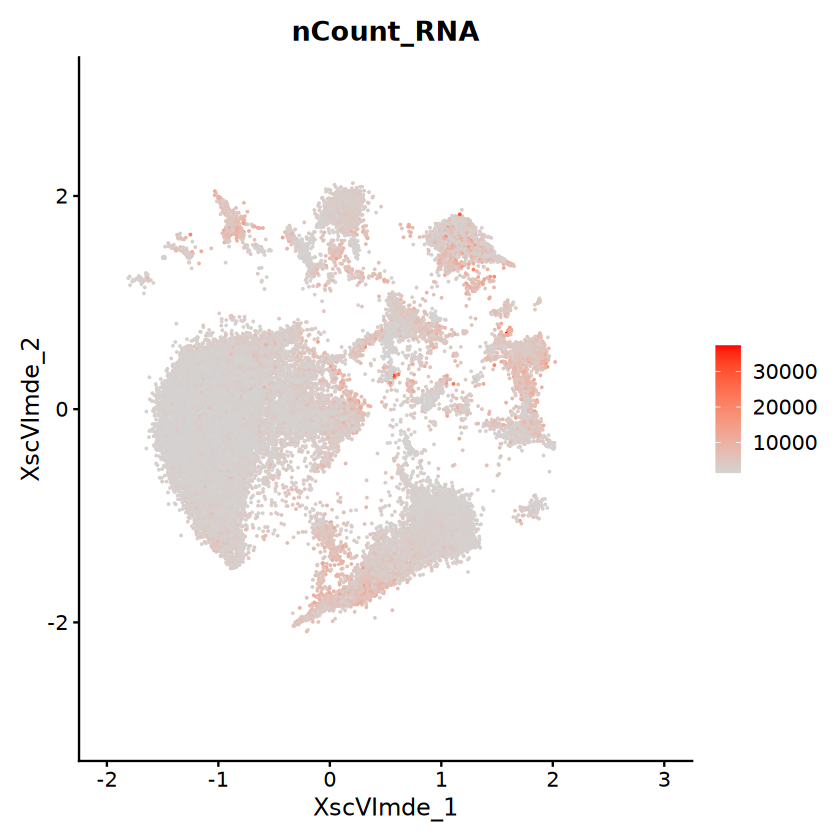

In [13]:
FeaturePlot(object = zheng_et_al_seurat,
            cols = c('lightgray', 'red'), # set two colours for gradients. 
            reduction = 'XscVImde_', 
            features =  "nCount_RNA")

Loading required package: SeuratExtendData

Loading required package: viridis

Loading required package: viridisLite

Loading required package: cowplot

The 'I want hue' color presets were generated from: https://medialab.github.io/iwanthue/
This message is shown once per session



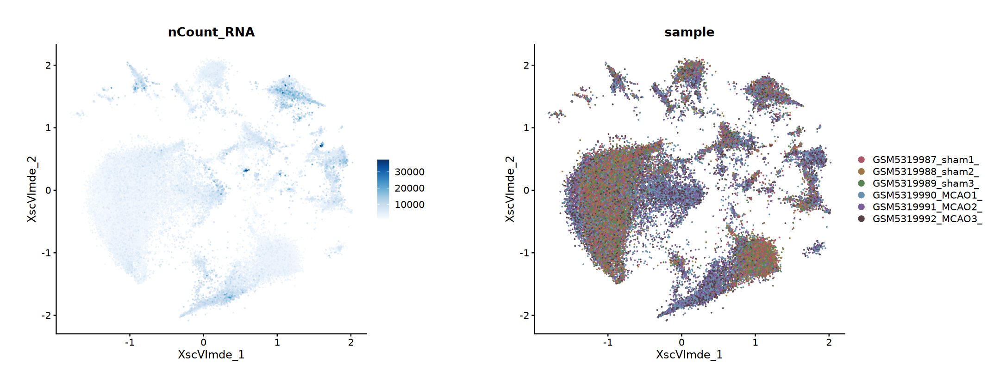

In [14]:
# Seurat Extend enables joint plotting of discrete and continous variables 
# inside seurat objects:

library(SeuratExtend)

options(repr.plot.width = 18, repr.plot.height = 7)

SeuratExtend::DimPlot2(seu = zheng_et_al_seurat,  
                       reduction = 'XscVImde_', 
                       features =  c("nCount_RNA", "sample")) & my_margin

In [15]:
# view samples form rownames:

zheng_et_al_seurat |> rownames() |> head()

[1] "Xkr4"    "Gm1992"  "Rp1"     "Sox17"   "Gm37323" "Mrpl15"

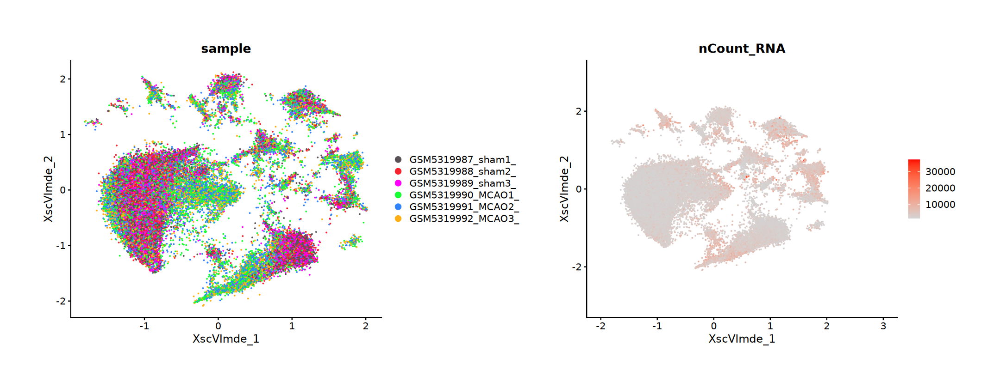

In [16]:
# In Seurat, we combine discrete and continuous variable plots with " + " as follows:

DimPlot(object = zheng_et_al_seurat,
            shuffle = TRUE,
            cols = my_colours,
            reduction = 'XscVImde_', 
            group.by =  "sample") + 
FeaturePlot(object = zheng_et_al_seurat,
            cols = c('lightgray', 'red'), # set two colours for gradients. 
            reduction = 'XscVImde_', 
            features =  "nCount_RNA") & my_margin

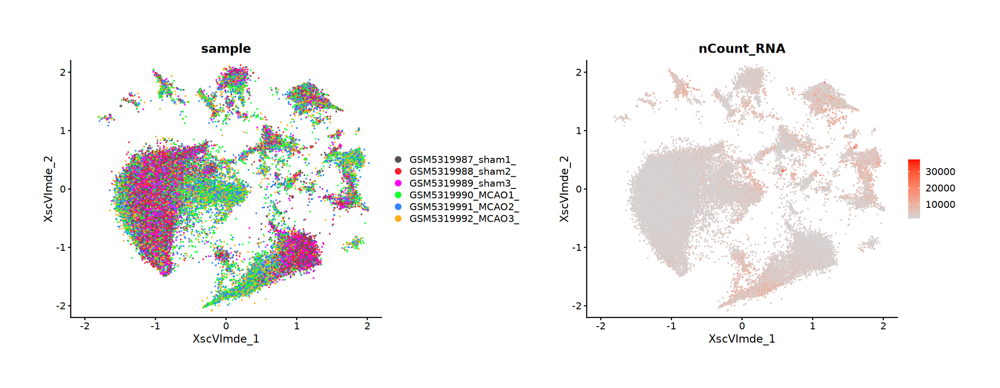

In [17]:
# Seurat applies different axis limits to the FeaturePlot and DimPlot
# products, although they have same embeddings data. We can override
# cartesian coordinates of both plots with same values:

options(repr.plot.width = 18, repr.plot.height = 7)

DimPlot(object = zheng_et_al_seurat,
            shuffle = TRUE,
            cols = my_colours,
            reduction = 'XscVImde_', 
            group.by =  "sample") + 
FeaturePlot(object = zheng_et_al_seurat,
            cols = c('lightgray', 'red'), # set two colours for gradients. 
            reduction = 'XscVImde_', 
            features =  "nCount_RNA") & my_margin & coord_cartesian(xlim = c(-2, 2), ylim = c(-2, 2))

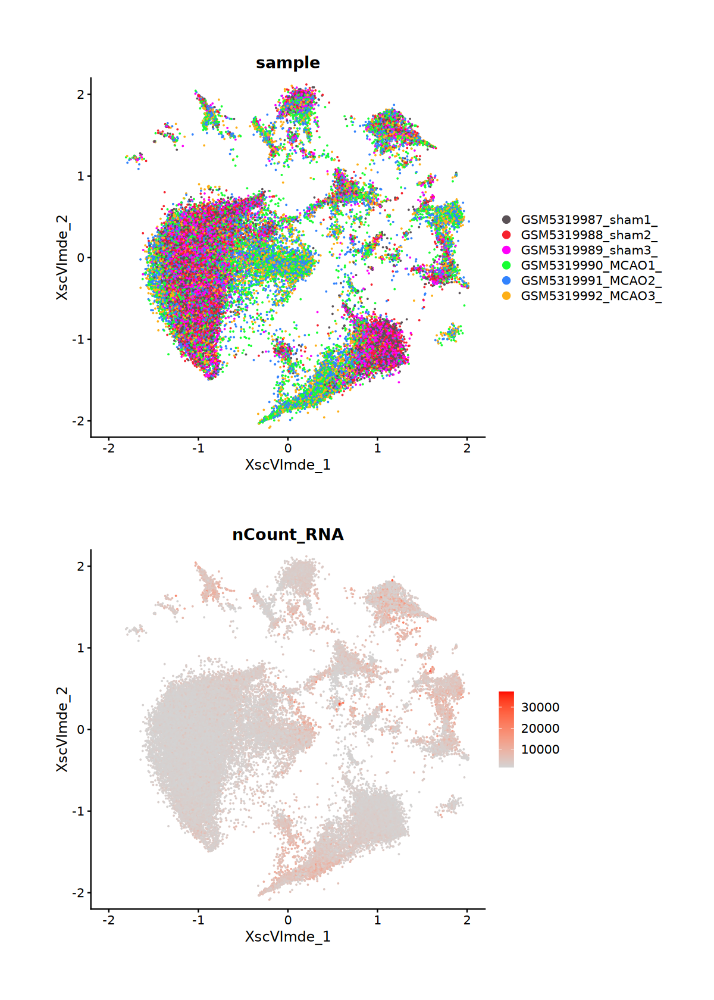

In [18]:
# Or join vertically with " / " :

options(repr.plot.width = 10, repr.plot.height = 14)

DimPlot(object = zheng_et_al_seurat,
            shuffle = TRUE,
            cols = my_colours,
            reduction = 'XscVImde_', 
            group.by =  "sample") / 
FeaturePlot(object = zheng_et_al_seurat,
            cols = c('lightgray', 'red'), # set two colours for gradients. 
            reduction = 'XscVImde_', 
            features =  "nCount_RNA") & my_margin & coord_cartesian(xlim = c(-2, 2), ylim = c(-2,2) )

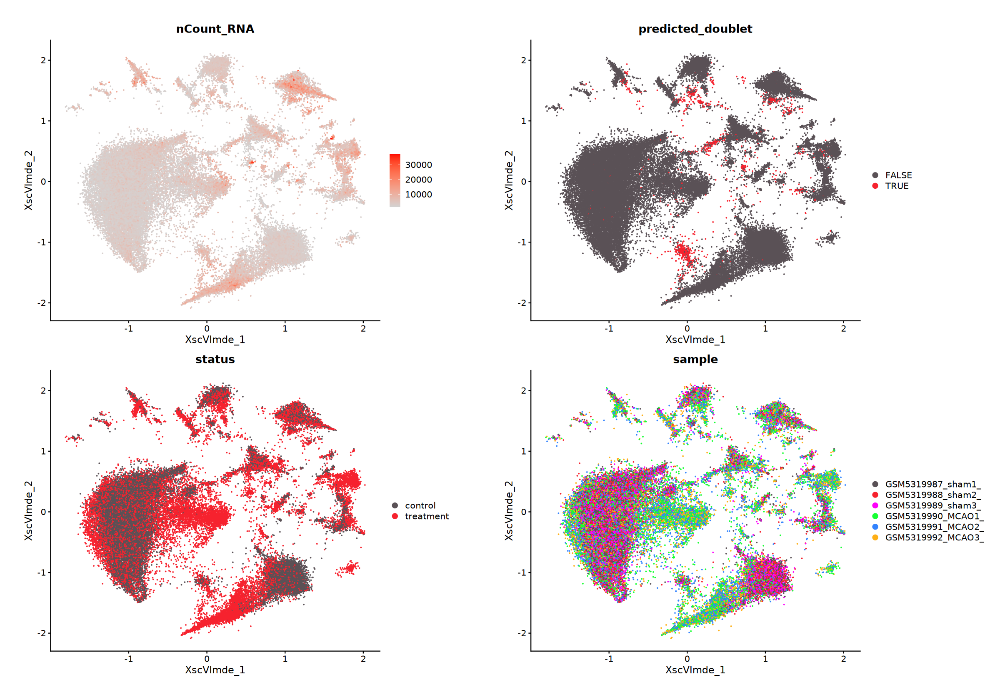

In [21]:
# SeuratExted applies same exis scale to both discrete and continuous vars.
# Note: It might sometimes override the preset plot size options.

options(repr.plot.width = 20, repr.plot.height = 14)

SeuratExtend::DimPlot2(seu = zheng_et_al_seurat,
                       cols = list(discrete = my_colours, continuous = c('lightgray', 'red')), 
                       reduction = 'XscVImde_', 
                       features =  c("nCount_RNA", "predicted_doublet", "status", "sample")) & my_margin

In [22]:
zheng_et_al_seurat[[]] |> colnames() |> print()

 [1] "orig.ident"                  "nCount_RNA"                 
 [3] "nFeature_RNA"                "_index"                     
 [5] "sample"                      "n_genes_by_counts"          
 [7] "log1p_n_genes_by_counts"     "total_counts"               
 [9] "log1p_total_counts"          "pct_counts_in_top_50_genes" 
[11] "pct_counts_in_top_100_genes" "pct_counts_in_top_200_genes"
[13] "pct_counts_in_top_500_genes" "total_counts_mt"            
[15] "log1p_total_counts_mt"       "pct_counts_mt"              
[17] "total_counts_ribo"           "log1p_total_counts_ribo"    
[19] "pct_counts_ribo"             "total_counts_hb"            
[21] "log1p_total_counts_hb"       "pct_counts_hb"              
[23] "n_genes"                     "doublet_score"              
[25] "predicted_doublet"           "status"                     
[27] "leiden"                      "_scvi_batch"                
[29] "_scvi_labels"               


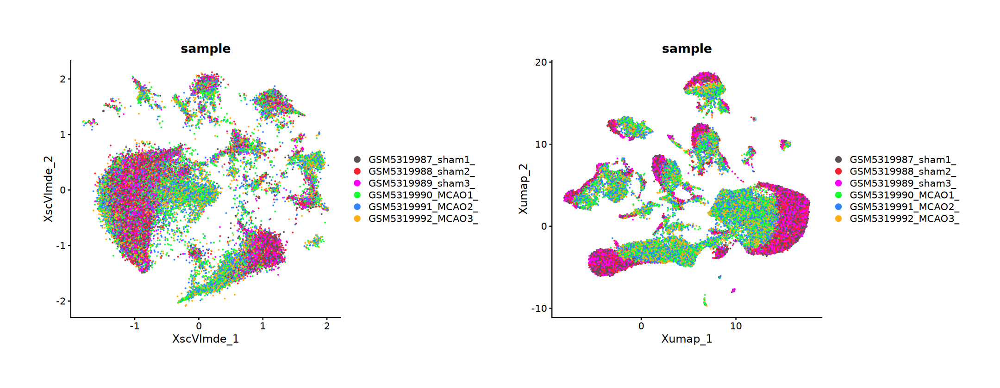

In [24]:
# View integrated vs non-integrated cell embeddings:

options(repr.plot.width = 18, repr.plot.height = 7)

scCustomize::DimPlot_scCustom(seurat_object = zheng_et_al_seurat, 
                              shuffle = TRUE, 
                              group.by = "sample", 
                              reduction = 'XscVImde_', 
                              colors_use = my_colours) + 
scCustomize::DimPlot_scCustom(seurat_object = zheng_et_al_seurat,  
                              shuffle = TRUE, 
                              group.by = "sample", 
                              reduction = 'Xumap_', 
                              colors_use = my_colours) & my_margin

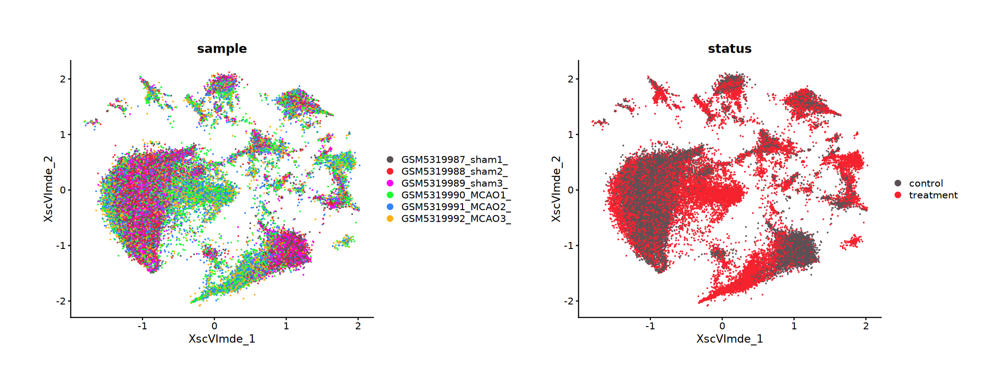

In [25]:
# compare cell islands with cell status identities:

DimPlot(object = zheng_et_al_seurat, shuffle = TRUE, group.by = c("sample", "status"), reduction = 'XscVImde_', cols = my_colours) & my_margin

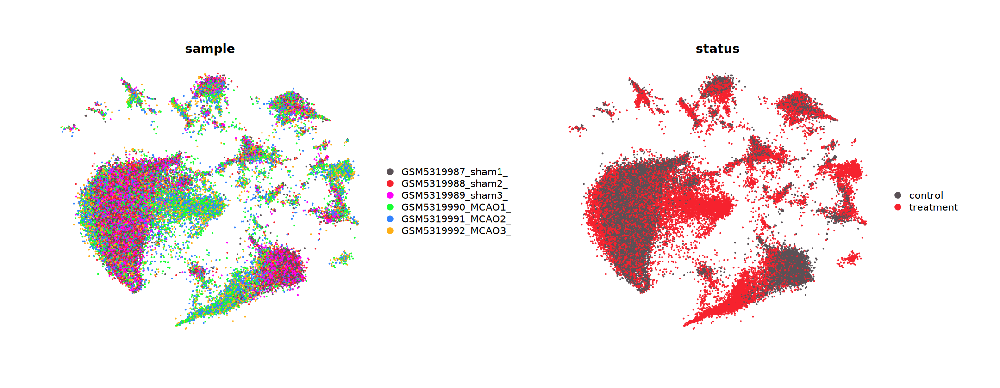

In [26]:
# Axes can be removed:

DimPlot(object = zheng_et_al_seurat, 
        shuffle = TRUE, group.by = c("sample", "status"), 
        reduction = 'XscVImde_', 
        cols = my_colours) & my_margin & NoAxes()

In [27]:
my_scVI_mde_coords <- coord_cartesian(xlim = c(-2, 2), ylim = c(-2, 2))

Warning message:
"All cells have the same value (0) of "pct_counts_mt""


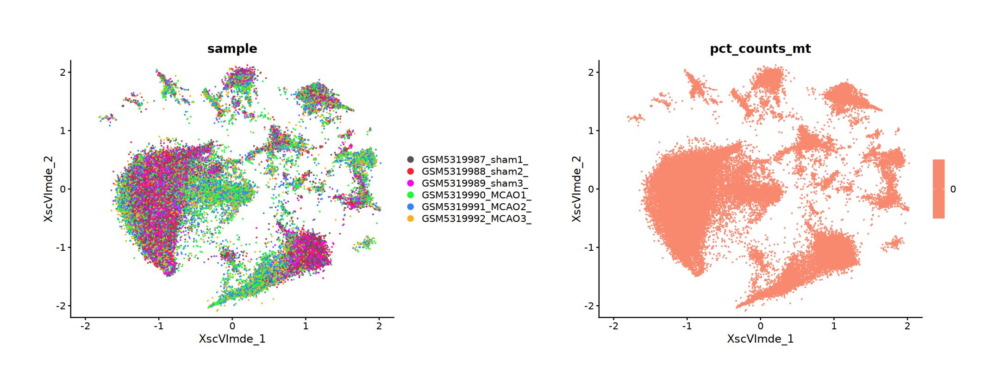

In [28]:
# View mito gene counts:

options(repr.plot.width = 18, repr.plot.height = 7)

DimPlot(object = zheng_et_al_seurat,
            shuffle = TRUE,
            cols = my_colours,
            reduction = 'XscVImde_', 
            group.by =  "sample") + 
FeaturePlot(object = zheng_et_al_seurat,
            cols = c('lightgray', 'red'), # set two colours for gradients. 
            reduction = 'XscVImde_', 
            features =  "pct_counts_mt") & my_margin & my_scVI_mde_coords

In [29]:
# there are either no mito genes so they are filtered out or a mito percentage
# calculation did not work properly.

Warning message:
"All cells have the same value (0) of "pct_counts_ribo""


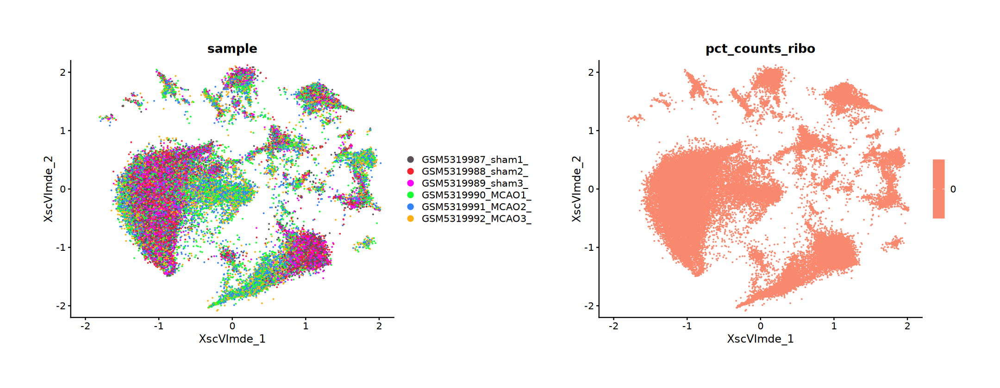

In [30]:
# check ribo gene count percentage:

options(repr.plot.width = 18, repr.plot.height = 7)

DimPlot(object = zheng_et_al_seurat,
            shuffle = TRUE,
            cols = my_colours,
            reduction = 'XscVImde_', 
            group.by =  "sample") + 
FeaturePlot(object = zheng_et_al_seurat,
            cols = c('lightgray', 'red'), # set two colours for gradients. 
            reduction = 'XscVImde_', 
            features =  "pct_counts_ribo") & my_margin & my_scVI_mde_coords

In [36]:
# same problem as with mito genes. Probably ScanPy commands could not be run properly.

# I will calculate those QC metrics again using scCustomise package.

In [31]:
# Take a glimpse at qc values:

zheng_et_al_seurat[[]] |> head() |> print()

                                        orig.ident nCount_RNA nFeature_RNA
AAACCTGAGCGAAGGG-1-GSM5319988_sham2_ SeuratProject       1438          933
AAACCTGAGCTAACAA-1-GSM5319988_sham2_ SeuratProject       1603          983
AAACCTGAGGCTAGCA-1-GSM5319988_sham2_ SeuratProject       2384         1298
AAACCTGAGGTGCACA-1-GSM5319988_sham2_ SeuratProject       2906         1309
AAACCTGAGTTTAGGA-1-GSM5319988_sham2_ SeuratProject       2928         1164
AAACCTGCAACACGCC-1-GSM5319988_sham2_ SeuratProject       2153         1175
                                                                   _index
AAACCTGAGCGAAGGG-1-GSM5319988_sham2_ AAACCTGAGCGAAGGG-1-GSM5319988_sham2_
AAACCTGAGCTAACAA-1-GSM5319988_sham2_ AAACCTGAGCTAACAA-1-GSM5319988_sham2_
AAACCTGAGGCTAGCA-1-GSM5319988_sham2_ AAACCTGAGGCTAGCA-1-GSM5319988_sham2_
AAACCTGAGGTGCACA-1-GSM5319988_sham2_ AAACCTGAGGTGCACA-1-GSM5319988_sham2_
AAACCTGAGTTTAGGA-1-GSM5319988_sham2_ AAACCTGAGTTTAGGA-1-GSM5319988_sham2_
AAACCTGCAACACGCC-1-GSM5319988_s

In [32]:
zheng_et_al_seurat[[]] |> summary()

         orig.ident      nCount_RNA     nFeature_RNA     _index         
 SeuratProject:58528   Min.   : 1401   Min.   : 150   Length:58528      
                       1st Qu.: 2072   1st Qu.:1113   Class :character  
                       Median : 2677   Median :1324   Mode  :character  
                       Mean   : 3384   Mean   :1457                     
                       3rd Qu.: 3984   3rd Qu.:1687                     
                       Max.   :37380   Max.   :7382                     
    sample          n_genes_by_counts log1p_n_genes_by_counts  total_counts  
 Length:58528       Min.   : 150      Min.   :5.017           Min.   : 1401  
 Class :character   1st Qu.:1113      1st Qu.:7.016           1st Qu.: 2072  
 Mode  :character   Median :1324      Median :7.189           Median : 2677  
                    Mean   :1457      Mean   :7.232           Mean   : 3384  
                    3rd Qu.:1687      3rd Qu.:7.431           3rd Qu.: 3984  
                    M

In [33]:
# They are all zero for ribo , mito and hb gene count percentages.

# Now, I will firstly update my mouse gene symbols according to
# the Mouse Genome Informatics (MGI) database. For this I will use 
# scCustome package:

# update mouse gene symbols:

updated_symbols <- scCustomize::Updated_MGI_Symbols(input_data = rownames(zheng_et_al_seurat))

Input features contained 19,707 gene symbols
v 18,142 were already approved symbols.
> 1,236 were updated to approved symbol.
x 335 were not found in MGI dataset and remain unchanged.


In [34]:
updated_symbols |> head()

,input_features,Approved_Symbol,Not_Found_Symbol,Updated_Symbol,Output_Features
,<chr>,<chr>,<chr>,<chr>,<chr>
1,Xkr4,Xkr4,NA,NA,Xkr4
2,Gm1992,Gm1992,NA,NA,Gm1992
3,Rp1,Rp1,NA,NA,Rp1
4,Sox17,Sox17,NA,NA,Sox17
5,Gm37323,Gm37323,NA,NA,Gm37323
6,Mrpl15,Mrpl15,NA,NA,Mrpl15


In [35]:
updated_symbols |> dim()

[1] 19713     5

In [36]:
rownames(zheng_et_al_seurat) |> length()

[1] 19707

In [37]:
setdiff(updated_symbols$input_features, rownames(zheng_et_al_seurat)) |> length()

[1] 0

In [38]:
updated_symbols$input_features |> duplicated() |> table()


FALSE  TRUE 
19707     6 

In [39]:
library(magrittr)

In [40]:
updated_symbols$input_features %>% duplicated() %>% updated_symbols$input_features[.]

[1] "Adss"   "Marc2"  "Lhfp"   "Aim1"   "Stra13" "G6b"

In [41]:
# probably, these have more than one approved aliases.

In [42]:
updated_symbols$input_features %>% duplicated() %>% updated_symbols$input_features[.] %>% dput()

c("Adss", "Marc2", "Lhfp", "Aim1", "Stra13", "G6b")


In [43]:
updated_symbols$input_features %in% c("Adss", "Marc2", "Lhfp", "Aim1", "Stra13", "G6b") %>% table()

.
FALSE  TRUE 
19701    12 

In [44]:
updated_symbols[updated_symbols$input_features %in% c("Adss", "Marc2", "Lhfp", "Aim1", "Stra13", "G6b"), ]

,input_features,Approved_Symbol,Not_Found_Symbol,Updated_Symbol,Output_Features
,<chr>,<chr>,<chr>,<chr>,<chr>
1122,Adss,NA,NA,Adss1,Adss1
1123,Adss,NA,NA,Adss2,Adss2
1194,Marc2,NA,NA,Nes,Nes
1195,Marc2,NA,NA,Mtarc2,Mtarc2
3638,Lhfp,NA,NA,Lhfpl6,Lhfpl6
3639,Lhfp,NA,NA,Lhfpl1,Lhfpl1
9834,Aim1,NA,NA,Crybg1,Crybg1
9835,Aim1,NA,NA,Slc45a2,Slc45a2
14875,Stra13,NA,NA,Cenpx,Cenpx


In [45]:
# In MGI database, those genes have more than one option.

# I will retrieve the original ensembl ids of those genes
#from their raw feature files:

adata_var_DF <- schard::h5ad2data.frame(here::here('python_objects', 'adata_scvi.h5ad'), 'var')

In [46]:
adata_var_DF %>% head()

,_index,gene_ids,feature_types,mt,ribo,hb,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts,n_cells,highly_variable,means,dispersions,dispersions_norm,highly_variable_nbatches,highly_variable_intersection
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>,<dbl>,<dbl>,<dbl>,<int>,<chr>
Xkr4,Xkr4,ENSMUSG00000051951,Gene Expression,FALSE,FALSE,FALSE,6,1.196009e-04,1.195937e-04,99.98975,7,2.079442,6,FALSE,6.653980e-05,-0.410382810,-1.2547028,0,FALSE
Gm1992,Gm1992,ENSMUSG00000089699,Gene Expression,FALSE,FALSE,FALSE,11,2.050301e-04,2.050091e-04,99.98121,12,2.564949,11,FALSE,9.657280e-05,-0.766264850,-2.2927423,0,FALSE
Rp1,Rp1,ENSMUSG00000025900,Gene Expression,FALSE,FALSE,FALSE,56,9.738929e-04,9.734189e-04,99.90432,57,4.060443,56,FALSE,9.653678e-04,0.136141530,0.2517748,1,FALSE
Sox17,Sox17,ENSMUSG00000025902,Gene Expression,FALSE,FALSE,FALSE,20427,7.097458e-01,5.363446e-01,65.09876,41540,10.634437,20427,TRUE,5.409998e-01,0.921112453,0.9580959,6,TRUE
Gm37323,Gm37323,ENSMUSG00000104328,Gene Expression,FALSE,FALSE,FALSE,4,6.834335e-05,6.834102e-05,99.99317,4,1.609438,4,FALSE,7.088433e-05,-0.008862914,-0.1296589,1,FALSE
Mrpl15,Mrpl15,ENSMUSG00000033845,Gene Expression,FALSE,FALSE,FALSE,12506,2.536393e-01,2.260507e-01,78.63245,14845,9.605486,12506,FALSE,1.794521e-01,-0.026220843,-0.1828669,0,FALSE


In [47]:
adata_var_DF %>% dim()

[1] 19707    19

In [48]:
identical(adata_var_DF$`_index`, rownames(zheng_et_al_seurat))

[1] TRUE

In [49]:
zheng_et_al_seurat@assays$RNA@meta.data$gene_symbols <- zheng_et_al_seurat %>% rownames()

In [50]:
zheng_et_al_seurat@assays$RNA@meta.data %>% head()

,gene_symbols
,<chr>
1,Xkr4
2,Gm1992
3,Rp1
4,Sox17
5,Gm37323
6,Mrpl15


In [51]:
new_metadata <- zheng_et_al_seurat@assays$RNA@meta.data %>% 
                dplyr::left_join(y = adata_var_DF[, c("_index", "gene_ids")], by = c("gene_symbols" = "_index"))

In [52]:
new_metadata %>% head()

,gene_symbols,gene_ids
,<chr>,<chr>
1,Xkr4,ENSMUSG00000051951
2,Gm1992,ENSMUSG00000089699
3,Rp1,ENSMUSG00000025900
4,Sox17,ENSMUSG00000025902
5,Gm37323,ENSMUSG00000104328
6,Mrpl15,ENSMUSG00000033845


In [53]:
identical(new_metadata$gene_symbols, rownames(zheng_et_al_seurat))

[1] TRUE

In [54]:
zheng_et_al_seurat@assays$RNA@meta.data <- new_metadata

In [55]:
new_metadata %>% dplyr::filter(gene_symbols %in% c("Adss", "Marc2", "Lhfp", "Aim1", "Stra13", "G6b"))

gene_symbols,gene_ids
<chr>,<chr>
Adss,ENSMUSG00000015961
Marc2,ENSMUSG00000073481
Lhfp,ENSMUSG00000048332
Aim1,ENSMUSG00000019866
Stra13,ENSMUSG00000025144
G6b,ENSMUSG00000073414


In [56]:
updated_symbols[updated_symbols$input_features %in% c("Adss", "Marc2", "Lhfp", "Aim1", "Stra13", "G6b"), ]

,input_features,Approved_Symbol,Not_Found_Symbol,Updated_Symbol,Output_Features
,<chr>,<chr>,<chr>,<chr>,<chr>
1122,Adss,NA,NA,Adss1,Adss1
1123,Adss,NA,NA,Adss2,Adss2
1194,Marc2,NA,NA,Nes,Nes
1195,Marc2,NA,NA,Mtarc2,Mtarc2
3638,Lhfp,NA,NA,Lhfpl6,Lhfpl6
3639,Lhfp,NA,NA,Lhfpl1,Lhfpl1
9834,Aim1,NA,NA,Crybg1,Crybg1
9835,Aim1,NA,NA,Slc45a2,Slc45a2
14875,Stra13,NA,NA,Cenpx,Cenpx


In [57]:
# I manually searched MGI database with ensembl ids and found the 
# corresponding approved symbols for these:

# "Adss", "Marc2", "Lhfp", "Aim1", "Stra13", "G6b"

# correct ones:

# Adss2, Mtarc2, Lhfpl6, Crybg1, Cenpx, Mpig6b

In [58]:
already_found_features <- setdiff(rownames(zheng_et_al_seurat), c("Adss", "Marc2", "Lhfp", "Aim1", "Stra13", "G6b"))

In [59]:
updated_symbols_filtered <- updated_symbols %>% dplyr::filter(input_features %in% already_found_features)

In [60]:
updated_symbols_filtered %>% dim()

[1] 19701     5

In [61]:
already_found_features %>% length()

[1] 19701

In [62]:
identical(updated_symbols_filtered$input_features, already_found_features)

[1] TRUE

In [63]:
new_df <- data.frame(old_gene_names = already_found_features, new_gene_names = updated_symbols_filtered$Output_Features)

In [64]:
new_df %>% head()

,old_gene_names,new_gene_names
,<chr>,<chr>
1,Xkr4,Xkr4
2,Gm1992,Gm1992
3,Rp1,Rp1
4,Sox17,Sox17
5,Gm37323,Gm37323
6,Mrpl15,Mrpl15


In [65]:
new_df %>% anyNA()

[1] FALSE

In [66]:
remaining_genes_df <- data.frame(old_gene_names = c("Adss", "Marc2", "Lhfp", "Aim1", "Stra13", "G6b"), 
                                 new_gene_names = c("Adss2", "Mtarc2", "Lhfpl6", "Crybg1", "Cenpx", "Mpig6b"))

In [67]:
remaining_genes_df %>% head()

,old_gene_names,new_gene_names
,<chr>,<chr>
1,Adss,Adss2
2,Marc2,Mtarc2
3,Lhfp,Lhfpl6
4,Aim1,Crybg1
5,Stra13,Cenpx
6,G6b,Mpig6b


In [68]:
complete_DF <- rbind(new_df, remaining_genes_df)

In [69]:
complete_DF %>% dim()

[1] 19707     2

In [70]:
complete_DF %>% head()

,old_gene_names,new_gene_names
,<chr>,<chr>
1,Xkr4,Xkr4
2,Gm1992,Gm1992
3,Rp1,Rp1
4,Sox17,Sox17
5,Gm37323,Gm37323
6,Mrpl15,Mrpl15


In [71]:
complete_DF %>% tail()

,old_gene_names,new_gene_names
,<chr>,<chr>
19702,Adss,Adss2
19703,Marc2,Mtarc2
19704,Lhfp,Lhfpl6
19705,Aim1,Crybg1
19706,Stra13,Cenpx
19707,G6b,Mpig6b


In [72]:
new_metadata %>% head()

,gene_symbols,gene_ids
,<chr>,<chr>
1,Xkr4,ENSMUSG00000051951
2,Gm1992,ENSMUSG00000089699
3,Rp1,ENSMUSG00000025900
4,Sox17,ENSMUSG00000025902
5,Gm37323,ENSMUSG00000104328
6,Mrpl15,ENSMUSG00000033845


In [73]:
new_metadata %>% dim()

[1] 19707     2

In [74]:
identical(new_metadata$gene_symbols, complete_DF$old_gene_names)

[1] FALSE

In [75]:
table(new_metadata$gene_symbols %in% complete_DF$old_gene_names)


 TRUE 
19707 

In [76]:
new_metadata <- dplyr::left_join(x = new_metadata, y = complete_DF, by = c("gene_symbols" = "old_gene_names"))

In [77]:
new_metadata %>% head()

,gene_symbols,gene_ids,new_gene_names
,<chr>,<chr>,<chr>
1,Xkr4,ENSMUSG00000051951,Xkr4
2,Gm1992,ENSMUSG00000089699,Gm1992
3,Rp1,ENSMUSG00000025900,Rp1
4,Sox17,ENSMUSG00000025902,Sox17
5,Gm37323,ENSMUSG00000104328,Gm37323
6,Mrpl15,ENSMUSG00000033845,Mrpl15


In [78]:
colnames(new_metadata)[1] <- 'old_gene_names'

In [79]:
new_metadata %>% head()

,old_gene_names,gene_ids,new_gene_names
,<chr>,<chr>,<chr>
1,Xkr4,ENSMUSG00000051951,Xkr4
2,Gm1992,ENSMUSG00000089699,Gm1992
3,Rp1,ENSMUSG00000025900,Rp1
4,Sox17,ENSMUSG00000025902,Sox17
5,Gm37323,ENSMUSG00000104328,Gm37323
6,Mrpl15,ENSMUSG00000033845,Mrpl15


In [80]:
identical(rownames(zheng_et_al_seurat), new_metadata$old_gene_names)

[1] TRUE

In [81]:
zheng_et_al_seurat@assays$RNA@meta.data <- new_metadata

In [82]:
zheng_et_al_seurat@assays$RNA@meta.data$new_gene_names %>% duplicated() %>% table()

.
FALSE  TRUE 
19688    19 

In [85]:
zheng_et_al_seurat@assays$RNA@meta.data$new_gene_names %>% 
duplicated() %>% 
zheng_et_al_seurat@assays$RNA@meta.data[.,]

,old_gene_names,gene_ids,new_gene_names
,<chr>,<chr>,<chr>
869,A830008E24Rik,ENSMUSG00000100627,A830008E24Rik
4471,Lrrc7,ENSMUSG00000028176,Lrrc7
4773,Pakap,ENSMUSG00000089945,Pakap
4774,Akap2,ENSMUSG00000038729,Pakap
5891,4930548H24Rik,ENSMUSG00000029138,Ccdc121
6319,A830010M20Rik,ENSMUSG00000044060,Btbd8
7282,Gm16499,ENSMUSG00000108255,Gm16499
9183,Micalcl,ENSMUSG00000030771,Mical2
9777,Gm16365,ENSMUSG00000086915,Gm16364


In [84]:
zheng_et_al_seurat@assays$RNA@meta.data$new_gene_names %>% 
duplicated() %>% 
zheng_et_al_seurat@assays$RNA@meta.data$old_gene_names[.]

[1] "A830008E24Rik" "Lrrc7"         "Pakap"         "Akap2"        
 [5] "4930548H24Rik" "A830010M20Rik" "Gm16499"       "Micalcl"      
 [9] "Gm16365"       "Gm29096"       "Gm6976"        "Arhgef18"     
[13] "Gm3460"        "Gm10251"       "Gm9780"        "Plac9b"       
[17] "Gm43951"       "Erdr1"         "Gm340"

In [86]:
zheng_et_al_seurat@assays$RNA@meta.data$new_unique_gene_names <- 
    make.unique(names = zheng_et_al_seurat@assays$RNA@meta.data$new_gene_names)

In [87]:
zheng_et_al_seurat@assays$RNA@meta.data$new_gene_names %>% 
duplicated() %>% 
zheng_et_al_seurat@assays$RNA@meta.data[.,]

,old_gene_names,gene_ids,new_gene_names,new_unique_gene_names
,<chr>,<chr>,<chr>,<chr>
869,A830008E24Rik,ENSMUSG00000100627,A830008E24Rik,A830008E24Rik.1
4471,Lrrc7,ENSMUSG00000028176,Lrrc7,Lrrc7.1
4773,Pakap,ENSMUSG00000089945,Pakap,Pakap.1
4774,Akap2,ENSMUSG00000038729,Pakap,Pakap.2
5891,4930548H24Rik,ENSMUSG00000029138,Ccdc121,Ccdc121.1
6319,A830010M20Rik,ENSMUSG00000044060,Btbd8,Btbd8.1
7282,Gm16499,ENSMUSG00000108255,Gm16499,Gm16499.1
9183,Micalcl,ENSMUSG00000030771,Mical2,Mical2.1
9777,Gm16365,ENSMUSG00000086915,Gm16364,Gm16364.1


In [88]:
rownames(zheng_et_al_seurat@assays$RNA) <- zheng_et_al_seurat@assays$RNA@meta.data$new_unique_gene_names

To only identify mitochondrial genes, one can get seqnames info using following commands:

In [89]:
# add mito info to gene symbols:

library(AnnotationHub)
ens.mm.v97 <- AnnotationHub()[["AH73905"]]

Loading required package: BiocGenerics


Attaching package: 'BiocGenerics'


The following object is masked from 'package:SeuratObject':

    intersect


The following objects are masked from 'package:stats':

    IQR, mad, sd, var, xtabs


The following objects are masked from 'package:base':

    Filter, Find, Map, Position, Reduce, anyDuplicated, aperm, append,
    as.data.frame, basename, cbind, colnames, dirname, do.call,
    duplicated, eval, evalq, get, grep, grepl, intersect, is.unsorted,
    lapply, mapply, match, mget, order, paste, pmax, pmax.int, pmin,
    pmin.int, rank, rbind, rownames, sapply, saveRDS, setdiff, table,
    tapply, union, unique, unsplit, which.max, which.min


Loading required package: BiocFileCache

Loading required package: dbplyr

loading from cache

require("ensembldb")



In [90]:
ens.mm.v97

EnsDb for Ensembl:
|Backend: SQLite
|Db type: EnsDb
|Type of Gene ID: Ensembl Gene ID
|Supporting package: ensembldb
|Db created by: ensembldb package from Bioconductor
|script_version: 0.3.4
|Creation time: Sun Jul  7 08:07:59 2019
|ensembl_version: 97
|ensembl_host: localhost
|Organism: Mus musculus
|taxonomy_id: 10090
|genome_build: GRCm38
|DBSCHEMAVERSION: 2.1
| No. of genes: 56393.
| No. of transcripts: 144404.
|Protein data available.

In [91]:
columns(ens.mm.v97) %>% print()

 [1] "DESCRIPTION"         "ENTREZID"            "EXONID"             
 [4] "EXONIDX"             "EXONSEQEND"          "EXONSEQSTART"       
 [7] "GENEBIOTYPE"         "GENEID"              "GENEIDVERSION"      
[10] "GENENAME"            "GENESEQEND"          "GENESEQSTART"       
[13] "INTERPROACCESSION"   "ISCIRCULAR"          "PROTDOMEND"         
[16] "PROTDOMSTART"        "PROTEINDOMAINID"     "PROTEINDOMAINSOURCE"
[19] "PROTEINID"           "PROTEINSEQUENCE"     "SEQCOORDSYSTEM"     
[22] "SEQLENGTH"           "SEQNAME"             "SEQSTRAND"          
[25] "SYMBOL"              "TXBIOTYPE"           "TXCDSSEQEND"        
[28] "TXCDSSEQSTART"       "TXID"                "TXIDVERSION"        
[31] "TXNAME"              "TXSEQEND"            "TXSEQSTART"         
[34] "TXSUPPORTLEVEL"      "UNIPROTDB"           "UNIPROTID"          
[37] "UNIPROTMAPPINGTYPE" 


In [92]:
chr.loc <- mapIds(ens.mm.v97, keys=rownames(zheng_et_al_seurat),
    keytype="SYMBOL", column=c("SEQNAME"))

Warning message:
"Unable to map 932 of 19707 requested IDs."


In [93]:
chr.loc %>% head()

Xkr4  Gm1992     Rp1   Sox17 Gm37323  Mrpl15 
    "1"     "1"     "1"     "1"     "1"     "1"

In [94]:
is.mito <- which(chr.loc=="MT")

In [95]:
is.mito %>% rownames(zheng_et_al_seurat)[.]

[1] "mt-Nd1"  "mt-Nd2"  "mt-Co1"  "mt-Co2"  "mt-Atp8" "mt-Atp6" "mt-Co3" 
 [8] "mt-Nd3"  "mt-Nd4l" "mt-Nd4"  "mt-Nd5"  "mt-Nd6"  "mt-Cytb"

In [96]:
chr.loc  %>% grep(pattern = 'MT', x = ., value = TRUE)

mt-Nd1  mt-Nd2  mt-Co1  mt-Co2 mt-Atp8 mt-Atp6  mt-Co3  mt-Nd3 mt-Nd4l  mt-Nd4 
   "MT"    "MT"    "MT"    "MT"    "MT"    "MT"    "MT"    "MT"    "MT"    "MT" 
 mt-Nd5  mt-Nd6 mt-Cytb 
   "MT"    "MT"    "MT"

===============================================================================================

However, since I updated the gene symbols to the most standart mouse genes on MGI database,\
now, I will use scCustomise package to caculate mito percentage of counts, along with\
some other info such as ribosomal gene percentage of counts etc.

I will create a temporary copy of the object, lest scCustomize can potentially override\
Scanpy-provided qc metrics

In [97]:
test_seurat <- 
    scCustomize::Add_Cell_QC_Metrics(object = zheng_et_al_seurat, species = 'Mouse')

* Adding Mito/Ribo Percentages to meta.data.
Adding Percent Mitochondrial genes for Mouse using gene symbol pattern: "^mt-".
Adding Percent Ribosomal genes for Mouse using gene symbol pattern: "^Rp[sl]".
Adding Percent Mito+Ribo by adding Mito & Ribo percentages.
* Adding Cell Complexity #1 (log10GenesPerUMI) to meta.data.
* Adding Cell Complexity #2 (Top 50 Percentages) to meta.data.
Calculating percent expressing top 50 for layer: counts
* Adding MSigDB Oxidative Phosphorylation, Apoptosis, and DNA Repair
  Percentages to meta.data.
Warning message:
"The following features were omitted as they were not found:
i Atp5a1, Atp5b, Atp5c1, Atp5d, Atp5e, Atp5g1, Atp5g2, Atp5g3, Atp5k, Atp5j2,
  Atp5l, Atp5h, Atp5j, Atp5o, and Ndufb1"
Warning message:
"The following features were omitted as they were not found:
i Bcl2l10 and Ccna1"
Warning message:
"The following features were omitted as they were not found:
i Hprt and Vps28"
* Adding IEG Percentages to meta.data.
Warning message:
"The follo

In [98]:
test_seurat@meta.data %>% colnames()

[1] "orig.ident"                  "nCount_RNA"                 
 [3] "nFeature_RNA"                "_index"                     
 [5] "sample"                      "n_genes_by_counts"          
 [7] "log1p_n_genes_by_counts"     "total_counts"               
 [9] "log1p_total_counts"          "pct_counts_in_top_50_genes" 
[11] "pct_counts_in_top_100_genes" "pct_counts_in_top_200_genes"
[13] "pct_counts_in_top_500_genes" "total_counts_mt"            
[15] "log1p_total_counts_mt"       "pct_counts_mt"              
[17] "total_counts_ribo"           "log1p_total_counts_ribo"    
[19] "pct_counts_ribo"             "total_counts_hb"            
[21] "log1p_total_counts_hb"       "pct_counts_hb"              
[23] "n_genes"                     "doublet_score"              
[25] "predicted_doublet"           "status"                     
[27] "leiden"                      "_scvi_batch"                
[29] "_scvi_labels"                "percent_mito"               
[31] "percent_ribo"                "percent_mito_ribo"          
[33] "log10GenesPerUMI"            "percent_top50"              
[35] "percent_oxphos"              "percent_apop"               
[37] "percent_dna_repair"          "percent_ieg"                
[39] "percent_hemo"

In [99]:
test_seurat@meta.data  %>% head() %>% print()

                                        orig.ident nCount_RNA nFeature_RNA
AAACCTGAGCGAAGGG-1-GSM5319988_sham2_ SeuratProject       1438          933
AAACCTGAGCTAACAA-1-GSM5319988_sham2_ SeuratProject       1603          983
AAACCTGAGGCTAGCA-1-GSM5319988_sham2_ SeuratProject       2384         1298
AAACCTGAGGTGCACA-1-GSM5319988_sham2_ SeuratProject       2906         1309
AAACCTGAGTTTAGGA-1-GSM5319988_sham2_ SeuratProject       2928         1164
AAACCTGCAACACGCC-1-GSM5319988_sham2_ SeuratProject       2153         1175
                                                                   _index
AAACCTGAGCGAAGGG-1-GSM5319988_sham2_ AAACCTGAGCGAAGGG-1-GSM5319988_sham2_
AAACCTGAGCTAACAA-1-GSM5319988_sham2_ AAACCTGAGCTAACAA-1-GSM5319988_sham2_
AAACCTGAGGCTAGCA-1-GSM5319988_sham2_ AAACCTGAGGCTAGCA-1-GSM5319988_sham2_
AAACCTGAGGTGCACA-1-GSM5319988_sham2_ AAACCTGAGGTGCACA-1-GSM5319988_sham2_
AAACCTGAGTTTAGGA-1-GSM5319988_sham2_ AAACCTGAGTTTAGGA-1-GSM5319988_sham2_
AAACCTGCAACACGCC-1-GSM5319988_s

In [100]:
# to see the new columns added by scCustomize:

test_seurat@meta.data %>% 
colnames() %>%
setdiff(zheng_et_al_seurat@meta.data %>% colnames)

[1] "percent_mito"       "percent_ribo"       "percent_mito_ribo" 
 [4] "log10GenesPerUMI"   "percent_top50"      "percent_oxphos"    
 [7] "percent_apop"       "percent_dna_repair" "percent_ieg"       
[10] "percent_hemo"

In [102]:
# scCustomize only adds cell cycle scores for the human species.
# I will use Seurat for mouse species. However, firstly, I need to
# convert seurat-provided cell cycle phase marking genes to 
# their mouse homologs.

In [103]:
# I will use SeuratExtend package for this conversion:

mouse_g2m.genes <- SeuratExtend::HumanToMouseGenesymbol(human_genes = Seurat::cc.genes.updated.2019$g2m.genes)

In [104]:
mouse_g2m.genes %>% head()

,MGI.symbol,HGNC.symbol
,<chr>,<chr>
1049,Anln,ANLN
1063,Anp32e,ANP32E
1625,Aurka,AURKA
1627,Aurkb,AURKB
1932,Birc5,BIRC5
2088,Bub1,BUB1


In [105]:
mouse_g2m.genes <- mouse_g2m.genes$MGI.symbol

In [106]:
mouse_s.genes <- SeuratExtend::HumanToMouseGenesymbol(human_genes = Seurat::cc.genes.updated.2019$s.genes)

In [107]:
mouse_s.genes %>% head()

,MGI.symbol,HGNC.symbol
,<chr>,<chr>
1940,Blm,BLM
2423,Casp8ap2,CASP8AP2
2665,Ccne2,CCNE2
2846,Cdc45,CDC45
2848,Cdc6,CDC6
2855,Cdca7,CDCA7


In [108]:
mouse_s.genes <- mouse_s.genes$MGI.symbol

In [109]:
# Check arguments of Seurat's CellCycleScoring function:

CellCycleScoring %>% args()

function (object, s.features, g2m.features, ctrl = NULL, set.ident = FALSE, 
    ...) 
NULL

In [110]:
# I will normalize the data to be able to use CellCycleScoring function:

NormalizeData %>% args()

function (object, ...) 
NULL

In [112]:
test_seurat <- NormalizeData(test_seurat)

Normalizing layer: counts



In [113]:
test_seurat <- CellCycleScoring(object = test_seurat, s.features = mouse_s.genes, g2m.features = mouse_g2m.genes)

In [114]:
test_seurat@meta.data %>% colnames %>% 
setdiff(zheng_et_al_seurat@meta.data %>% colnames())

[1] "percent_mito"       "percent_ribo"       "percent_mito_ribo" 
 [4] "log10GenesPerUMI"   "percent_top50"      "percent_oxphos"    
 [7] "percent_apop"       "percent_dna_repair" "percent_ieg"       
[10] "percent_hemo"       "S.Score"            "G2M.Score"         
[13] "Phase"

In [115]:
new_columns <- test_seurat@meta.data %>% colnames %>% 
                setdiff(zheng_et_al_seurat@meta.data %>% colnames())

In [116]:
test_seurat[['Phase']] %>% head()

,Phase
,<chr>
AAACCTGAGCGAAGGG-1-GSM5319988_sham2_,G2M
AAACCTGAGCTAACAA-1-GSM5319988_sham2_,G2M
AAACCTGAGGCTAGCA-1-GSM5319988_sham2_,S
AAACCTGAGGTGCACA-1-GSM5319988_sham2_,G2M
AAACCTGAGTTTAGGA-1-GSM5319988_sham2_,G2M
AAACCTGCAACACGCC-1-GSM5319988_sham2_,G2M


In [118]:
Cells(test_seurat) %>% head()

[1] "AAACCTGAGCGAAGGG-1-GSM5319988_sham2_"
[2] "AAACCTGAGCTAACAA-1-GSM5319988_sham2_"
[3] "AAACCTGAGGCTAGCA-1-GSM5319988_sham2_"
[4] "AAACCTGAGGTGCACA-1-GSM5319988_sham2_"
[5] "AAACCTGAGTTTAGGA-1-GSM5319988_sham2_"
[6] "AAACCTGCAACACGCC-1-GSM5319988_sham2_"

In [119]:
identical(Cells(test_seurat), Cells(zheng_et_al_seurat))

[1] TRUE

In [125]:
# Or using colnames():

identical(colnames(test_seurat), Cells(test_seurat))

[1] TRUE

In [126]:
identical(Cells(test_seurat), Cells(zheng_et_al_seurat))

[1] TRUE

In [129]:
zheng_et_al_seurat@meta.data %>% colnames()

[1] "orig.ident"                  "nCount_RNA"                 
 [3] "nFeature_RNA"                "_index"                     
 [5] "sample"                      "n_genes_by_counts"          
 [7] "log1p_n_genes_by_counts"     "total_counts"               
 [9] "log1p_total_counts"          "pct_counts_in_top_50_genes" 
[11] "pct_counts_in_top_100_genes" "pct_counts_in_top_200_genes"
[13] "pct_counts_in_top_500_genes" "total_counts_mt"            
[15] "log1p_total_counts_mt"       "pct_counts_mt"              
[17] "total_counts_ribo"           "log1p_total_counts_ribo"    
[19] "pct_counts_ribo"             "total_counts_hb"            
[21] "log1p_total_counts_hb"       "pct_counts_hb"              
[23] "n_genes"                     "doublet_score"              
[25] "predicted_doublet"           "status"                     
[27] "leiden"                      "_scvi_batch"                
[29] "_scvi_labels"

In [130]:
new_columns

[1] "percent_mito"       "percent_ribo"       "percent_mito_ribo" 
 [4] "log10GenesPerUMI"   "percent_top50"      "percent_oxphos"    
 [7] "percent_apop"       "percent_dna_repair" "percent_ieg"       
[10] "percent_hemo"       "S.Score"            "G2M.Score"         
[13] "Phase"

In [131]:
# add all qc metrics to the original seurat object:

for (each_metric in new_columns) {
  zheng_et_al_seurat[[each_metric]] <- test_seurat[[each_metric]]
}

In [132]:
zheng_et_al_seurat@meta.data %>% colnames()

[1] "orig.ident"                  "nCount_RNA"                 
 [3] "nFeature_RNA"                "_index"                     
 [5] "sample"                      "n_genes_by_counts"          
 [7] "log1p_n_genes_by_counts"     "total_counts"               
 [9] "log1p_total_counts"          "pct_counts_in_top_50_genes" 
[11] "pct_counts_in_top_100_genes" "pct_counts_in_top_200_genes"
[13] "pct_counts_in_top_500_genes" "total_counts_mt"            
[15] "log1p_total_counts_mt"       "pct_counts_mt"              
[17] "total_counts_ribo"           "log1p_total_counts_ribo"    
[19] "pct_counts_ribo"             "total_counts_hb"            
[21] "log1p_total_counts_hb"       "pct_counts_hb"              
[23] "n_genes"                     "doublet_score"              
[25] "predicted_doublet"           "status"                     
[27] "leiden"                      "_scvi_batch"                
[29] "_scvi_labels"                "percent_mito"               
[31] "percent_ribo"                "percent_mito_ribo"          
[33] "log10GenesPerUMI"            "percent_top50"              
[35] "percent_oxphos"              "percent_apop"               
[37] "percent_dna_repair"          "percent_ieg"                
[39] "percent_hemo"                "S.Score"                    
[41] "G2M.Score"                   "Phase"

In [133]:
new_columns %>% length()

[1] 13

In [134]:
ls()

[1] "adata_var_DF"                     "already_found_features"          
 [3] "chr.loc"                          "complete_DF"                     
 [5] "each_metric"                      "ens.mm.v97"                      
 [7] "is.mito"                          "mouse_g2m.genes"                 
 [9] "mouse_s.genes"                    "my_colours"                      
[11] "my_margin"                        "my_scVI_mde_coords"              
[13] "my_seurat_extend_scCustomize_lib" "my_theme"                        
[15] "new_columns"                      "new_df"                          
[17] "new_metadata"                     "remaining_genes_df"              
[19] "test_seurat"                      "updated_symbols"                 
[21] "updated_symbols_filtered"         "x"                               
[23] "zheng_et_al_seurat"

In [135]:
rm(test_seurat)

In [137]:
# View all cellular metadata features:

In [138]:
metadata <- zheng_et_al_seurat@meta.data

In [139]:
metadata |> sapply(class) |> unique()

[1] "factor"    "numeric"   "integer"   "character"

In [140]:
metadata |> head() |> print()

                                        orig.ident nCount_RNA nFeature_RNA
AAACCTGAGCGAAGGG-1-GSM5319988_sham2_ SeuratProject       1438          933
AAACCTGAGCTAACAA-1-GSM5319988_sham2_ SeuratProject       1603          983
AAACCTGAGGCTAGCA-1-GSM5319988_sham2_ SeuratProject       2384         1298
AAACCTGAGGTGCACA-1-GSM5319988_sham2_ SeuratProject       2906         1309
AAACCTGAGTTTAGGA-1-GSM5319988_sham2_ SeuratProject       2928         1164
AAACCTGCAACACGCC-1-GSM5319988_sham2_ SeuratProject       2153         1175
                                                                   _index
AAACCTGAGCGAAGGG-1-GSM5319988_sham2_ AAACCTGAGCGAAGGG-1-GSM5319988_sham2_
AAACCTGAGCTAACAA-1-GSM5319988_sham2_ AAACCTGAGCTAACAA-1-GSM5319988_sham2_
AAACCTGAGGCTAGCA-1-GSM5319988_sham2_ AAACCTGAGGCTAGCA-1-GSM5319988_sham2_
AAACCTGAGGTGCACA-1-GSM5319988_sham2_ AAACCTGAGGTGCACA-1-GSM5319988_sham2_
AAACCTGAGTTTAGGA-1-GSM5319988_sham2_ AAACCTGAGTTTAGGA-1-GSM5319988_sham2_
AAACCTGCAACACGCC-1-GSM5319988_s

In [177]:
# remove all zero columns:

metadata %>%
  dplyr::select(where(is.numeric)) %>%  # Select only numeric columns
  colSums() %>% 
  print()

                 nCount_RNA                nFeature_RNA 
               1.980547e+08                8.525523e+07 
          n_genes_by_counts     log1p_n_genes_by_counts 
               8.525752e+07                4.232833e+05 
               total_counts          log1p_total_counts 
               1.980571e+08                4.680328e+05 
 pct_counts_in_top_50_genes pct_counts_in_top_100_genes 
               1.935025e+06                2.438314e+06 
pct_counts_in_top_200_genes pct_counts_in_top_500_genes 
               3.065791e+06                4.088995e+06 
            total_counts_mt       log1p_total_counts_mt 
               0.000000e+00                0.000000e+00 
              pct_counts_mt           total_counts_ribo 
               0.000000e+00                0.000000e+00 
    log1p_total_counts_ribo             pct_counts_ribo 
               0.000000e+00                0.000000e+00 
            total_counts_hb       log1p_total_counts_hb 
               0.000000e+00    

In [180]:
# retrieve names of zero columns:

metadata %>%
  dplyr::select(where(is.numeric)) %>%  # Select only numeric columns
  colSums() %>% 
  .[. == 0] %>% 
  names()

[1] "total_counts_mt"         "log1p_total_counts_mt"  
 [3] "pct_counts_mt"           "total_counts_ribo"      
 [5] "log1p_total_counts_ribo" "pct_counts_ribo"        
 [7] "total_counts_hb"         "log1p_total_counts_hb"  
 [9] "pct_counts_hb"           "_scvi_labels"

In [181]:
zero_cols <- metadata %>%
  dplyr::select(where(is.numeric)) %>%  # Select only numeric columns
  colSums() %>% 
  .[. == 0] %>% 
  names()

In [182]:
zero_cols <- zero_cols %>% setdiff('_scvi_labels')

In [183]:
# remove these columns:

for (each_col in zero_cols){

    zheng_et_al_seurat[[each_col]] <- NULL
    
    }

In [185]:
zheng_et_al_seurat %>% .@meta.data %>% colnames()

[1] "orig.ident"                  "nCount_RNA"                 
 [3] "nFeature_RNA"                "_index"                     
 [5] "sample"                      "n_genes_by_counts"          
 [7] "log1p_n_genes_by_counts"     "total_counts"               
 [9] "log1p_total_counts"          "pct_counts_in_top_50_genes" 
[11] "pct_counts_in_top_100_genes" "pct_counts_in_top_200_genes"
[13] "pct_counts_in_top_500_genes" "n_genes"                    
[15] "doublet_score"               "predicted_doublet"          
[17] "status"                      "leiden"                     
[19] "_scvi_batch"                 "_scvi_labels"               
[21] "percent_mito"                "percent_ribo"               
[23] "percent_mito_ribo"           "log10GenesPerUMI"           
[25] "percent_top50"               "percent_oxphos"             
[27] "percent_apop"                "percent_dna_repair"         
[29] "percent_ieg"                 "percent_hemo"               
[31] "S.Score"                     "G2M.Score"                  
[33] "Phase"

In [186]:
metadata <- zheng_et_al_seurat@meta.data

In [188]:
metadata %>% head() %>% print()

                                        orig.ident nCount_RNA nFeature_RNA
AAACCTGAGCGAAGGG-1-GSM5319988_sham2_ SeuratProject       1438          933
AAACCTGAGCTAACAA-1-GSM5319988_sham2_ SeuratProject       1603          983
AAACCTGAGGCTAGCA-1-GSM5319988_sham2_ SeuratProject       2384         1298
AAACCTGAGGTGCACA-1-GSM5319988_sham2_ SeuratProject       2906         1309
AAACCTGAGTTTAGGA-1-GSM5319988_sham2_ SeuratProject       2928         1164
AAACCTGCAACACGCC-1-GSM5319988_sham2_ SeuratProject       2153         1175
                                                                   _index
AAACCTGAGCGAAGGG-1-GSM5319988_sham2_ AAACCTGAGCGAAGGG-1-GSM5319988_sham2_
AAACCTGAGCTAACAA-1-GSM5319988_sham2_ AAACCTGAGCTAACAA-1-GSM5319988_sham2_
AAACCTGAGGCTAGCA-1-GSM5319988_sham2_ AAACCTGAGGCTAGCA-1-GSM5319988_sham2_
AAACCTGAGGTGCACA-1-GSM5319988_sham2_ AAACCTGAGGTGCACA-1-GSM5319988_sham2_
AAACCTGAGTTTAGGA-1-GSM5319988_sham2_ AAACCTGAGTTTAGGA-1-GSM5319988_sham2_
AAACCTGCAACACGCC-1-GSM5319988_s

In [189]:
metadata$`_scvi_batch` %>% unique()

[1] 1 2 3 5 0 4

In [190]:
metadata$`_scvi_labels` %>% unique()

[1] 0

In [191]:
# I will convert scvi_batch and scvi_laber as factor since they are discrete variables:

metadata$`_scvi_batch`  <- as.factor(metadata$`_scvi_batch`)

In [192]:
metadata$`_scvi_labels` <- as.factor(metadata$`_scvi_labels`)

In [193]:
# extract the colname of discrete variables:

discrete_vars <- colnames(metadata)[sapply(metadata, function(x) { (is.character(x) || is.factor(x)) && length(unique(x)) <= 100 } ) ] # except cell barcodes

In [194]:
discrete_vars |> print()

[1] "orig.ident"        "sample"            "predicted_doublet"
[4] "status"            "leiden"            "_scvi_batch"      
[7] "_scvi_labels"      "Phase"            


In [195]:
# extract the colname of continuous variables:

continuous_vars <- continuous_vars <- colnames(metadata)[sapply(metadata, function(x) { is.numeric(x) || is.integer(x) } )]

In [196]:
continuous_vars |> print()

 [1] "nCount_RNA"                  "nFeature_RNA"               
 [3] "n_genes_by_counts"           "log1p_n_genes_by_counts"    
 [5] "total_counts"                "log1p_total_counts"         
 [7] "pct_counts_in_top_50_genes"  "pct_counts_in_top_100_genes"
 [9] "pct_counts_in_top_200_genes" "pct_counts_in_top_500_genes"
[11] "n_genes"                     "doublet_score"              
[13] "percent_mito"                "percent_ribo"               
[15] "percent_mito_ribo"           "log10GenesPerUMI"           
[17] "percent_top50"               "percent_oxphos"             
[19] "percent_apop"                "percent_dna_repair"         
[21] "percent_ieg"                 "percent_hemo"               
[23] "S.Score"                     "G2M.Score"                  


In [197]:
metadata |> colnames() |> print()

 [1] "orig.ident"                  "nCount_RNA"                 
 [3] "nFeature_RNA"                "_index"                     
 [5] "sample"                      "n_genes_by_counts"          
 [7] "log1p_n_genes_by_counts"     "total_counts"               
 [9] "log1p_total_counts"          "pct_counts_in_top_50_genes" 
[11] "pct_counts_in_top_100_genes" "pct_counts_in_top_200_genes"
[13] "pct_counts_in_top_500_genes" "n_genes"                    
[15] "doublet_score"               "predicted_doublet"          
[17] "status"                      "leiden"                     
[19] "_scvi_batch"                 "_scvi_labels"               
[21] "percent_mito"                "percent_ribo"               
[23] "percent_mito_ribo"           "log10GenesPerUMI"           
[25] "percent_top50"               "percent_oxphos"             
[27] "percent_apop"                "percent_dna_repair"         
[29] "percent_ieg"                 "percent_hemo"               
[31] "S.Score"           

In [203]:
plot_list_continuous_vars <- list()

for (each_feature in continuous_vars) {

 plot_list_continuous_vars[[each_feature]] <- 
        FeaturePlot(object = zheng_et_al_seurat,
            cols = c('lightgray', 'red'), # set two colours for gradients. 
            reduction = 'XscVImde_', 
            features =  each_feature) + my_margin & my_scVI_mde_coords
}

In [204]:
plot_list_continuous_vars |> length()

[1] 24

In [205]:
total_plots <- length(plot_list_continuous_vars)
plot_per_col <- 2

In [206]:
options(repr.plot.width = 9*plot_per_col, repr.plot.height = 7*(total_plots/2))

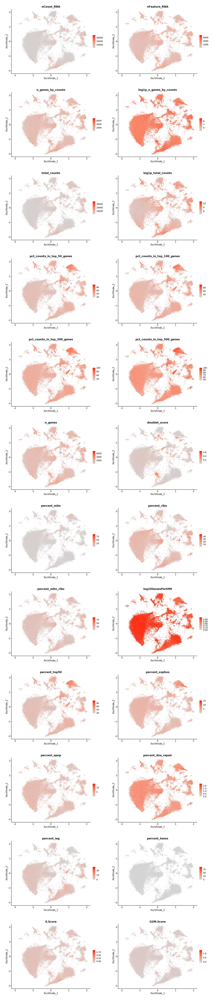

In [207]:
patchwork::wrap_plots(plot_list_continuous_vars, ncol = 2)

In [208]:
plot_list_discrete_vars <- list()

for (each_feature in discrete_vars) {

 plot_list_discrete_vars[[each_feature]] <- 
        DimPlot(object = zheng_et_al_seurat,
            shuffle = TRUE,
            cols = my_colours,
            reduction = 'XscVImde_', 
            group.by =  each_feature) + my_margin + my_scVI_mde_coords
}

In [209]:
plot_list_discrete_vars |> length()

[1] 8

In [210]:
total_plots <- length(plot_list_discrete_vars)
plot_per_col <- 2

In [211]:
options(repr.plot.width = 9*plot_per_col, repr.plot.height = 7*(total_plots/2))

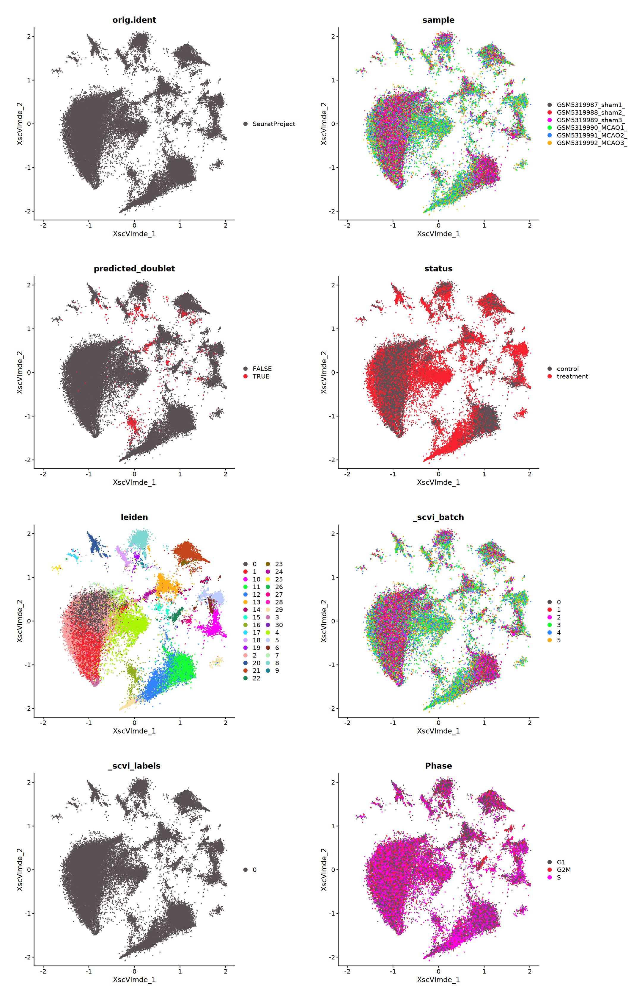

In [212]:
patchwork::wrap_plots(plot_list_discrete_vars, ncol = plot_per_col)

IMPORTANT NOTE: 

As writing functions, avoid using default arguments that reference to itself, like below:

my_func <- function(seurat_object = seurat_object, my_colours = my_colours, my_margin = my_margin)

It throws error !!!

==================================================================================================

leiden clusters are detected using unintegrated data by ScanPy. I will remove them and run it again !!!

In [215]:
# write a function to generate discrete variable plot:

plot_discrete_vars <- function(seurat_object, discrete_vars, my_reduction, my_colours, my_margin) { 

plot_list_discrete_vars <- list()

    
for (each_feature in discrete_vars) {

 plot_list_discrete_vars[[each_feature]] <- 
        DimPlot(object = seurat_object,
            shuffle = TRUE,
            cols = my_colours,
            reduction = my_reduction, 
            group.by =  each_feature) + my_margin
}

    return(plot_list_discrete_vars)
    
}

In [217]:
plot_list_discrete_vars <- plot_discrete_vars(seurat_object = zheng_et_al_seurat, 
                                               my_reduction = 'XscVImde_', 
                                               discrete_vars = discrete_vars, 
                                               my_colours = my_colours, 
                                               my_margin = my_margin)

In [218]:
total_plots <- length(plot_list_discrete_vars)
plot_per_col <- 2

In [219]:
options(repr.plot.width = 9*plot_per_col, repr.plot.height = 7*(total_plots/2))

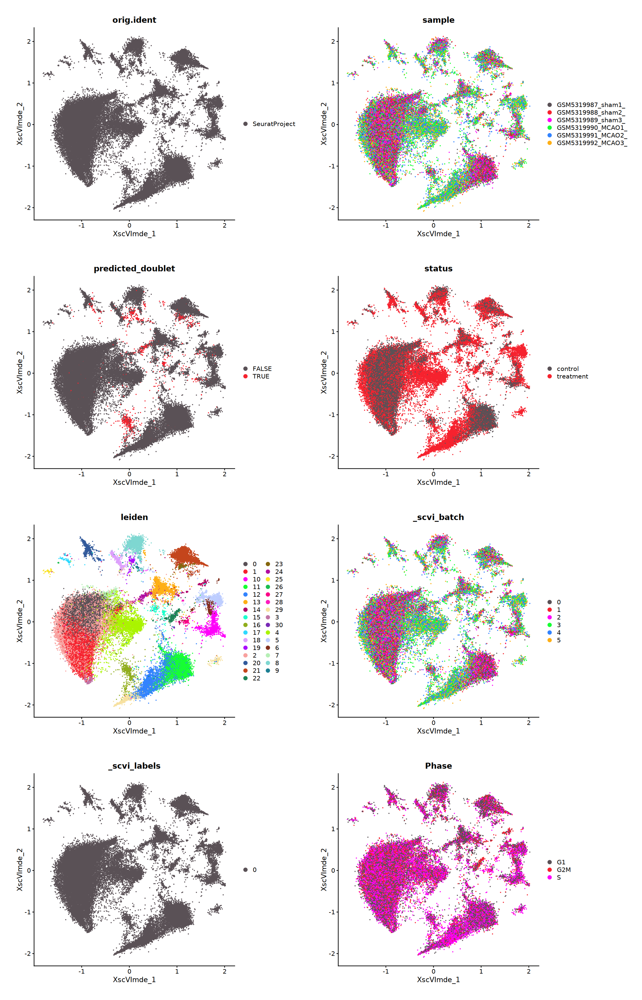

In [220]:
patchwork::wrap_plots(plot_list_discrete_vars, ncol = plot_per_col)

In [222]:
# Now I will write a function generate continuous variables plots:

plot_continuous_vars <- function(seurat_object, continuous_vars, my_reduction, my_colours, my_margin) { 

plot_list_continuous_vars <- list()

for (each_feature in continuous_vars) {

 plot_list_continuous_vars[[each_feature]] <- 
        FeaturePlot(object = seurat_object,
            cols = c('lightgray', 'red'), # set two colours for gradients. 
            reduction = my_reduction, 
            features =  each_feature) + my_margin
}

    return(plot_list_continuous_vars)
    
}

In [240]:
plot_list_continuous_vars <- plot_continuous_vars(seurat_object = zheng_et_al_seurat,
                                                  continuous_vars = continuous_vars, 
                                                  my_reduction = 'XscVImde_', 
                                                  my_colours = my_colours, 
                                                  my_margin = my_margin
                                                 )

In [241]:
total_plots <- length(plot_list_continuous_vars)
plot_per_col <- 2

In [242]:
options(repr.plot.width = 9*plot_per_col, repr.plot.height = 7*(total_plots/2))

In [255]:
plot_list_continuous_vars %>% names()

[1] "nCount_RNA"                  "nFeature_RNA"               
 [3] "n_genes_by_counts"           "log1p_n_genes_by_counts"    
 [5] "total_counts"                "log1p_total_counts"         
 [7] "pct_counts_in_top_50_genes"  "pct_counts_in_top_100_genes"
 [9] "pct_counts_in_top_200_genes" "pct_counts_in_top_500_genes"
[11] "n_genes"                     "doublet_score"              
[13] "percent_mito"                "percent_ribo"               
[15] "percent_mito_ribo"           "log10GenesPerUMI"           
[17] "percent_top50"               "percent_oxphos"             
[19] "percent_apop"                "percent_dna_repair"         
[21] "percent_ieg"                 "percent_hemo"               
[23] "S.Score"                     "G2M.Score"

In [256]:
for (each_plot in plot_list_continuous_vars) {

    each_plot %>% class() %>% print()

    }

[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   
[1] "patchwork" "gg"        "ggplot"   


In [257]:
plot_list_continuous_vars_corrected <- list()

for (each_plot in names(plot_list_continuous_vars)) {

    plot_list_continuous_vars_corrected[[each_plot]] <- plot_list_continuous_vars[[each_plot]] + my_scVI_mde_coords

    }

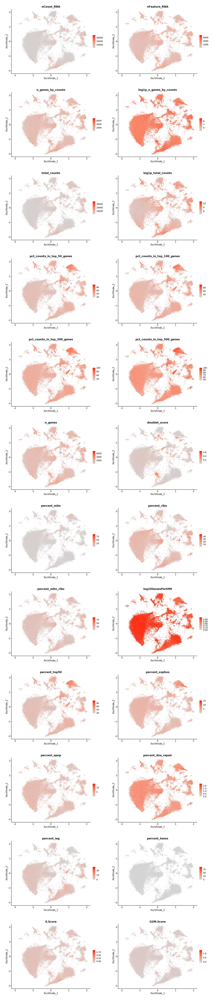

In [259]:
patchwork::wrap_plots(plot_list_continuous_vars_corrected, ncol = plot_per_col)

THIS IS THE END OF FIRST PART OF PART_4B NOTEBOOK.

THE REST OF THE COMMANDS CAN BE FOUND IN THE SECOND PART OF PART_4B NOTEBOOK.

NOTE: I splitted this notebook into two parts to facilitate github storage.